## PIV Plot

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib_scalebar.scalebar import SI_LENGTH

In [ ]:
imgDir = r'I:\Google Drive\Code\MATLAB\Zhengyang\Research\misc\PIV\40x30fps80od_100p0rk_9vt1500.tif'
dataDir = r'I:\Google Drive\Code\MATLAB\Zhengyang\Research\misc\PIV\PIVlab_frame1500.txt'
data = pd.read_csv(dataDir, names=['X', 'Y', 'U', 'V', 'a', 'b', 
                                    'c', 'd', 'e', 'f', 'g'])
xlen = 65
ylen = 65
names = ['X', 'Y', 'U', 'V']
pdata = {}
pdatao = {}
for name in names:
    pdatao[name] = np.array(data[name]).reshape((xlen,ylen))
    pdata[name] = pdatao[name][0:xlen:3, 0:ylen:3]
plt.figure(figsize=(10, 10))
ax = plt.gca()
img = plt.imread(imgDir)
plt.imshow(img, cmap='gray')
plt.quiver(pdata['X'], pdata['Y'], pdata['U'], -pdata['V'], color='yellow',
          headlength=10, headwidth=6, minshaft=-1)
# plt.streamplot(np.array(data['X'].unique()), np.array(1000-data['Y'].unique()), 
#                datao['U'], -pdatao['V'], density=2)
plt.axis('off')
plt.axis('equal')
plt.savefig('PIV.png', dpi=300)

In [ ]:
from matplotlib.figure import Figure
from matplotlib.patches import Rectangle
ax = {}
dpi = 72
figsize = []
for i in range(len(img.shape)):
    figsize.append(img.shape[i] / dpi)
figsize = tuple(figsize)
fig = Figure(figsize=figsize, dpi=dpi)
ax['main'] = fig.add_axes([0,0,1,1])
ax['main'].axis('off')
ax['main'].imshow(img, cmap='gray')
ax['main'].quiver(pdata['X'], pdata['Y'], pdata['U'], -pdata['V'], color='yellow',
          headlength=10, headwidth=6, minshaft=-1)
window_size = (100, 100)
magn = 3
window_ori = (234, 383)
window_img = img[window_ori[1]:window_ori[1]+window_size[1], 
                 window_ori[0]:window_ori[0]+window_size[0]]
window_imgsize = []
window_padsize = []
for i in range(2):
    window_imgsize.append(window_size[i]*magn)
border_width = 5
for i in range(2):    
    window_padsize.append(window_imgsize[i] + border_width)
x = (img.shape[0] - window_padsize[0]) / img.shape[0]
y = 0 / img.shape[1]
w = window_padsize[0] / img.shape[0]
h = window_padsize[1] / img.shape[1]
ax['window_pad'] = fig.add_axes([x, y, w, h])
ax['window_pad'].axis('off')
ax['window_pad'].add_artist(Rectangle((0,0), window_padsize[0], 
                                      window_padsize[1], color='white'))
x = (img.shape[0] - window_imgsize[0]) / img.shape[0]
y = 0 / img.shape[1]
w = window_imgsize[0] / img.shape[0]
h = window_imgsize[1] / img.shape[1]
ax['window_img'] = fig.add_axes([x, y, w, h])
ax['window_img'].axis('off')
ax['window_img'].imshow(window_img, cmap='gray')
fig

In [ ]:
(1, 2) , (3, 4)

# Tracking figure colorbar

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import colors
color = []
theta = np.linspace(0, 2*np.pi, 400)
for t in theta:
    if t > np.pi:
        t -= np.pi
    cohsv = ((np.pi-t)/np.pi, 1, 1)
    corgb = colors.hsv_to_rgb(cohsv)
    color.append(corgb)
cnum = range(0, len(color))
cmap = colors.ListedColormap(color)
x = np.cos(theta)
y = np.sin(theta)
plt.scatter(x, y, marker='o', s=400, cmap=cmap, c=cnum)
plt.axis('equal')
plt.axis('off')
plt.savefig('circ_colorbar.pdf', format='pdf')

In [ ]:
color = []
theta = np.linspace(0, np.pi, 400)
for t in theta:
    if t > np.pi:
        t -= np.pi
    cohsv = ((np.pi-t)/np.pi, 1, 1)
    corgb = colors.hsv_to_rgb(cohsv)
    color.append(corgb)
cnum = range(0, len(color))
cmap = colors.ListedColormap(color)
x = np.zeros((len(theta), 1))
y = theta
plt.scatter(x, y, marker='s', s=400, cmap=cmap, c=cnum)
plt.axis('equal')
plt.axis('off')
plt.savefig('normal_colorbar.png', dpi=300)
plt.savefig('normal_colorbar.svg', format='svg')
plt.savefig('normal_colorbar.pdf', format='pdf')
plt.savefig('normal_colorbar.eps', format='eps')

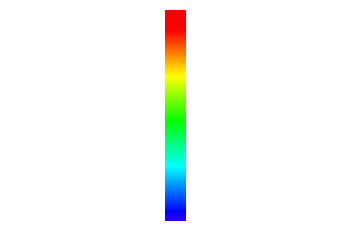

In [168]:
color = []
theta = np.linspace(.3*np.pi, np.pi, 400)
for t in theta:
    if t > np.pi:
        t -= np.pi
    cohsv = ((np.pi-t)/np.pi, 1, 1)
    corgb = colors.hsv_to_rgb(cohsv)
    color.append(corgb)
cnum = range(0, len(color))
cmap = colors.ListedColormap(color)
x = np.zeros((len(theta), 1))
y = theta
plt.scatter(x, y, marker='s', s=400, cmap=cmap, c=cnum)
plt.axis('equal')
plt.axis('off')
# plt.savefig('normal_colorbar.png', dpi=300)
# plt.savefig('normal_colorbar.svg', format='svg')
# plt.savefig('normal_colorbar.pdf', format='pdf')
plt.savefig('rainbow.eps', format='eps')

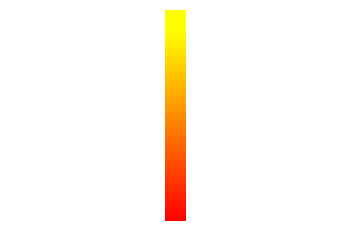

In [169]:
plt.scatter(x, y, marker='s', s=400, cmap='autumn', c=cnum)
plt.axis('equal')
plt.axis('off')
plt.savefig('autumn.eps', format='eps')

# Rainbow colored PIV

In [43]:
imgDir = r'I:\Google Drive\Code\Python\Peng\PIV_rainbow\40x30fps80od_100p0rk_9vt1500.tif'
dataDir = r'I:\Google Drive\Code\Python\Peng\PIV_rainbow\fig1.dat'
img = plt.imread(imgDir)
data = pd.read_csv(dataDir, names=['X', 'Y', 'U', 'V', 'C'], sep='\t')
xlen = 65
ylen = 65
names = ['X', 'Y', 'U', 'V', 'C']
pdata = {}
pdatao = {}
for name in names:
    pdatao[name] = np.array(data[name]).reshape((xlen,ylen))
    pdata[name] = pdatao[name][0:xlen:3, 0:ylen:3]

In [56]:
for i in range(0, pdata['C'].shape[0]):
    for j in range(0, pdata['C'].shape[1]):
        if pdata['C'][i, j] < 0:
            pdata['C'][i, j] = 0
        elif pdata['C'][i, j] > 0.9:
            pdata['C'][i, j] = 1
        else:
            pdata['C'][i, j] = pdata['C'][i, j] / 0.9

## Arrow every 3 boxes

* Scale down +, dots +

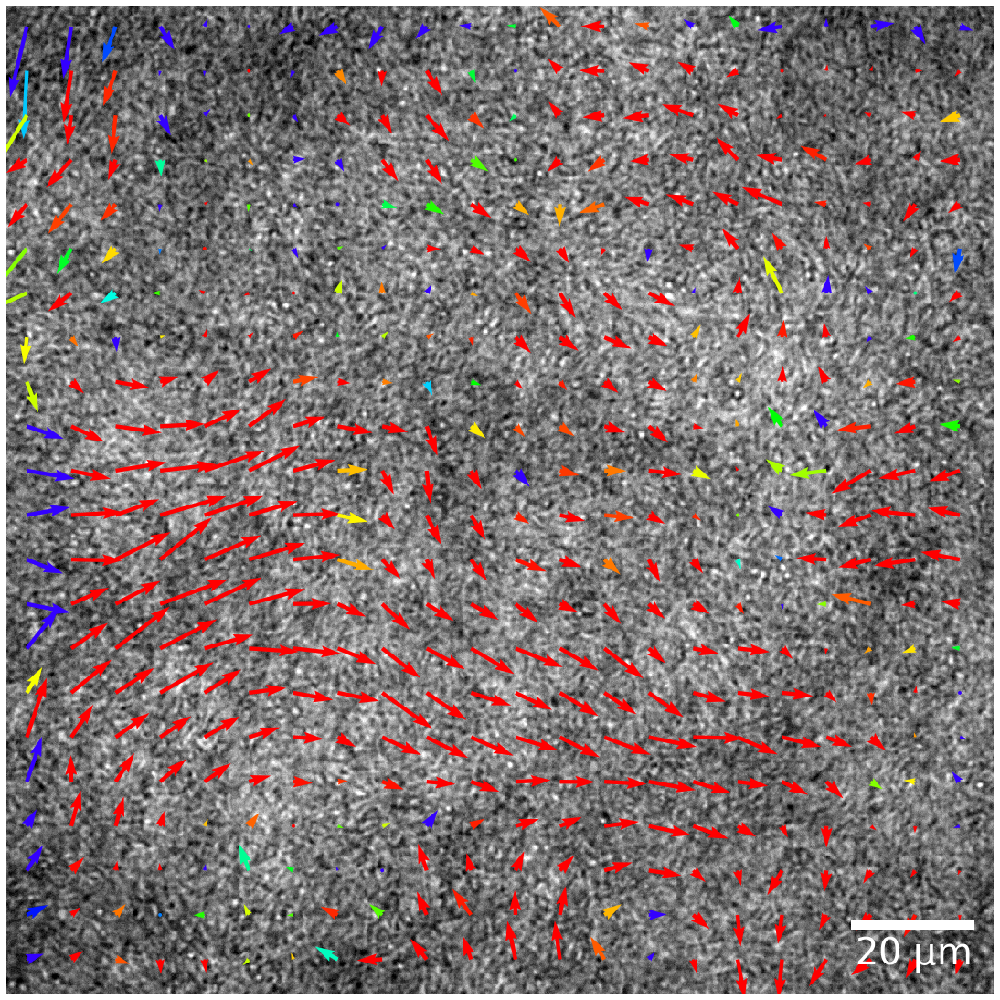

In [66]:
figsize = (15, 15)
fig = plt.figure(figsize=figsize)

ax = fig.add_axes([0,0,1,1])
img2 = np.flipud(img)
ax.imshow(img2, cmap='gray')
ax.quiver(pdata['X'], pdata['Y'], pdata['U'], -pdata['V'], pdata['C'], cmap=cmap,
          minshaft=1, minlength=1, width=0.004, joinstyle='round')
#           headlength=3, headwidth=2, minshaft=-1, width=0.005, minlength=0, headaxislength=2)
ax.axis('off')
scalebar = ScaleBar(0.16, 'um', SI_LENGTH, frameon=False, color='white', font_properties={'size': 40},
                   pad=2, location='lower right', fixed_value=20) # 1 pixel = 0.2 1/cm
ax.add_artist(scalebar)
# fig.savefig('PIV_rainbow-im.eps', format='eps')
# fig.savefig('PIV_rainbow-im.pdf', format='pdf')
# fig.savefig('PIV_rainbow-im.png', format='png', dpi=300)

* Scale down -, dots +

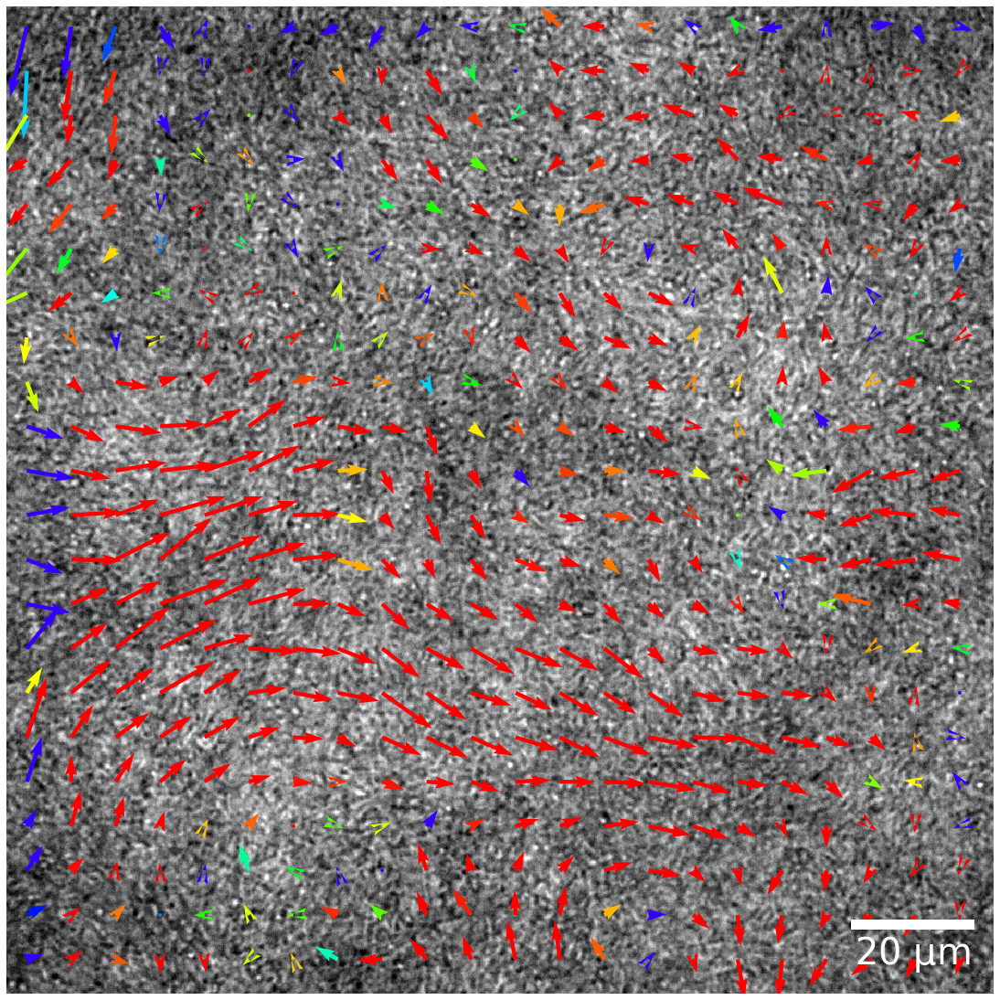

In [60]:
figsize = (15, 15)
fig = plt.figure(figsize=figsize)

ax = fig.add_axes([0,0,1,1])
img2 = np.flipud(img)
ax.imshow(img2, cmap='gray')
ax.quiver(pdata['X'], pdata['Y'], pdata['U'], -pdata['V'], pdata['C'], cmap=cmap,
          minshaft=-1, minlength=1, width=0.004, joinstyle='round')
#           headlength=3, headwidth=2, minshaft=-1, width=0.005, minlength=0, headaxislength=2)
ax.axis('off')
scalebar = ScaleBar(0.16, 'um', SI_LENGTH, frameon=False, color='white', font_properties={'size': 40},
                   pad=2, location='lower right', fixed_value=20) # 1 pixel = 0.2 1/cm
ax.add_artist(scalebar)
# fig.savefig('PIV_rainbow-im.eps', format='eps')
# fig.savefig('PIV_rainbow-im.pdf', format='pdf')
# fig.savefig('PIV_rainbow-im.png', format='png', dpi=300)

* Scale down +, dots -

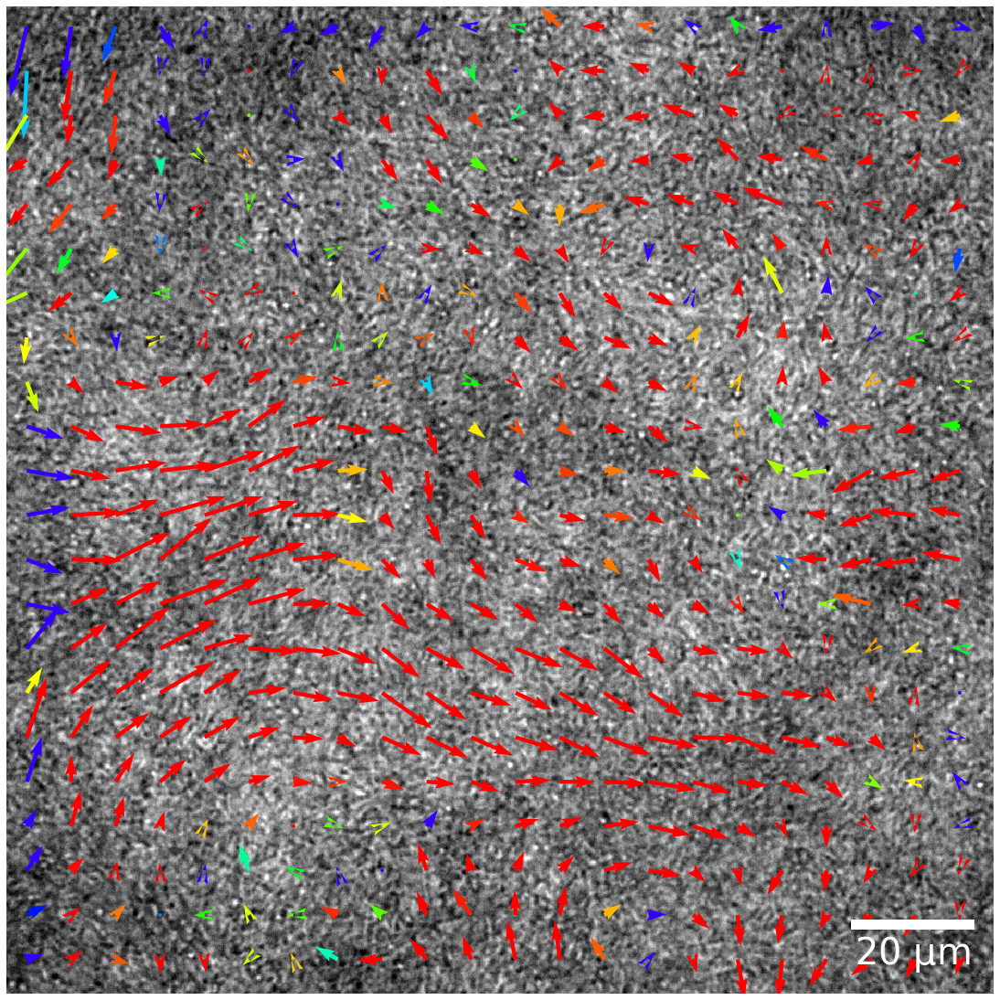

In [65]:
figsize = (15, 15)
fig = plt.figure(figsize=figsize)

ax = fig.add_axes([0,0,1,1])
img2 = np.flipud(img)
ax.imshow(img2, cmap='gray')
ax.quiver(pdata['X'], pdata['Y'], pdata['U'], -pdata['V'], pdata['C'], cmap=cmap,
          minshaft=-1, minlength=1, width=0.004, joinstyle='round')
#           headlength=3, headwidth=2, minshaft=-1, width=0.005, minlength=0, headaxislength=2)
ax.axis('off')
scalebar = ScaleBar(0.16, 'um', SI_LENGTH, frameon=False, color='white', font_properties={'size': 40},
                   pad=2, location='lower right', fixed_value=20) # 1 pixel = 0.2 1/cm
ax.add_artist(scalebar)
# fig.savefig('PIV_rainbow-im.eps', format='eps')
# fig.savefig('PIV_rainbow-im.pdf', format='pdf')
# fig.savefig('PIV_rainbow-im.png', format='png', dpi=300)

* Scale down -, dots -

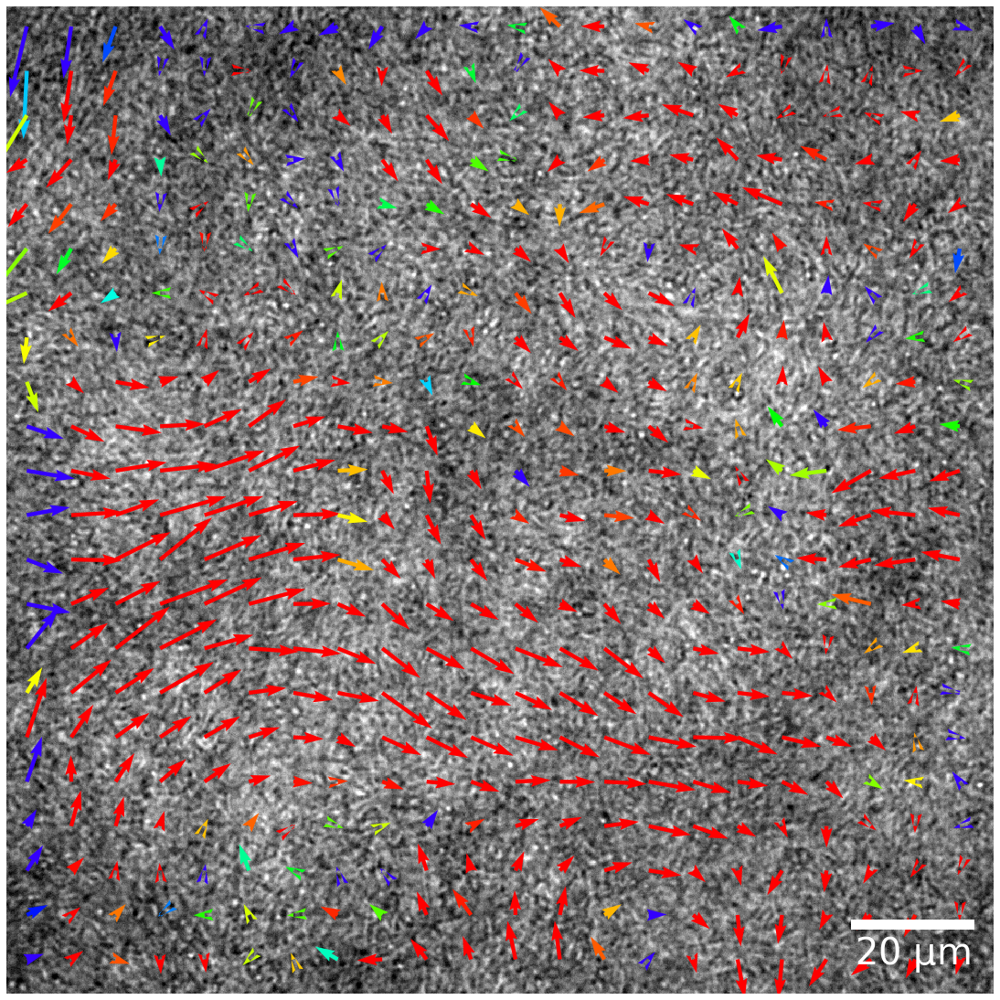

In [59]:
figsize = (15, 15)
fig = plt.figure(figsize=figsize)

ax = fig.add_axes([0,0,1,1])
img2 = np.flipud(img)
ax.imshow(img2, cmap='gray')
ax.quiver(pdata['X'], pdata['Y'], pdata['U'], -pdata['V'], pdata['C'], cmap=cmap,
          minshaft=-1, minlength=0, width=0.004)
#           headlength=3, headwidth=2, minshaft=-1, width=0.005, minlength=0, headaxislength=2)
ax.axis('off')
scalebar = ScaleBar(0.16, 'um', SI_LENGTH, frameon=False, color='white', font_properties={'size': 40},
                   pad=2, location='lower right', fixed_value=20) # 1 pixel = 0.2 1/cm
ax.add_artist(scalebar)
# fig.savefig('PIV_rainbow-im.eps', format='eps')
# fig.savefig('PIV_rainbow-im.pdf', format='pdf')
# fig.savefig('PIV_rainbow-im.png', format='png', dpi=300)

# Plot arrows for every other box

In [67]:
data = pd.read_csv(dataDir, names=['X', 'Y', 'U', 'V', 'C'], sep='\t')
xlen = 65
ylen = 65
names = ['X', 'Y', 'U', 'V', 'C']
pdata = {}
pdatao = {}
for name in names:
    pdatao[name] = np.array(data[name]).reshape((xlen,ylen))
    pdata[name] = pdatao[name][0:xlen:2, 0:ylen:2]

In [68]:
for i in range(0, pdata['C'].shape[0]):
    for j in range(0, pdata['C'].shape[1]):
        if pdata['C'][i, j] < 0:
            pdata['C'][i, j] = 0
        elif pdata['C'][i, j] > 0.9:
            pdata['C'][i, j] = 1
        else:
            pdata['C'][i, j] = pdata['C'][i, j] / 0.9

* Scale down +, dots +

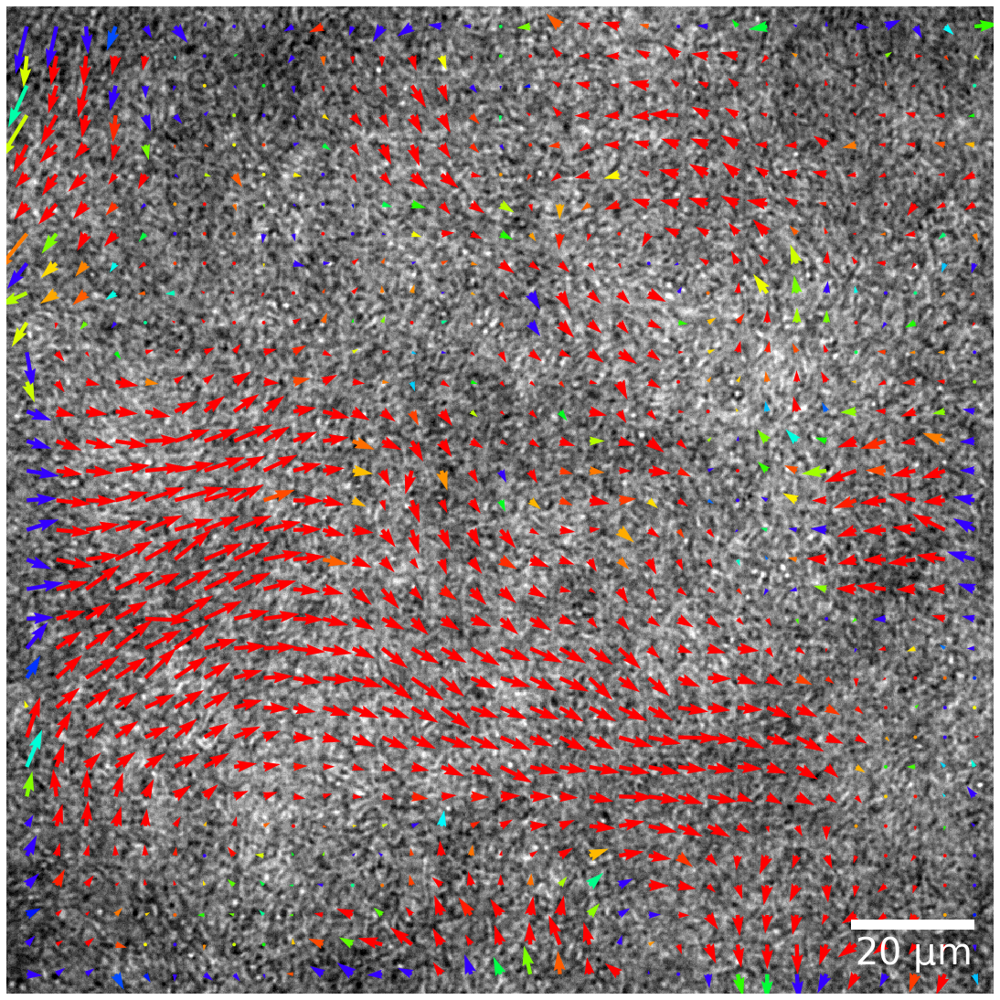

In [69]:
figsize = (15, 15)
fig = plt.figure(figsize=figsize)

ax = fig.add_axes([0,0,1,1])
img2 = np.flipud(img)
ax.imshow(img2, cmap='gray')
ax.quiver(pdata['X'], pdata['Y'], pdata['U'], -pdata['V'], pdata['C'], cmap=cmap,
          minshaft=1, minlength=1, width=0.004, joinstyle='round')
#           headlength=3, headwidth=2, minshaft=-1, width=0.005, minlength=0, headaxislength=2)
ax.axis('off')
scalebar = ScaleBar(0.16, 'um', SI_LENGTH, frameon=False, color='white', font_properties={'size': 40},
                   pad=2, location='lower right', fixed_value=20) # 1 pixel = 0.2 1/cm
ax.add_artist(scalebar)
# fig.savefig('PIV_rainbow-im.eps', format='eps')
# fig.savefig('PIV_rainbow-im.pdf', format='pdf')
# fig.savefig('PIV_rainbow-im.png', format='png', dpi=300)

In [ ]:
# Scale down -, dots +

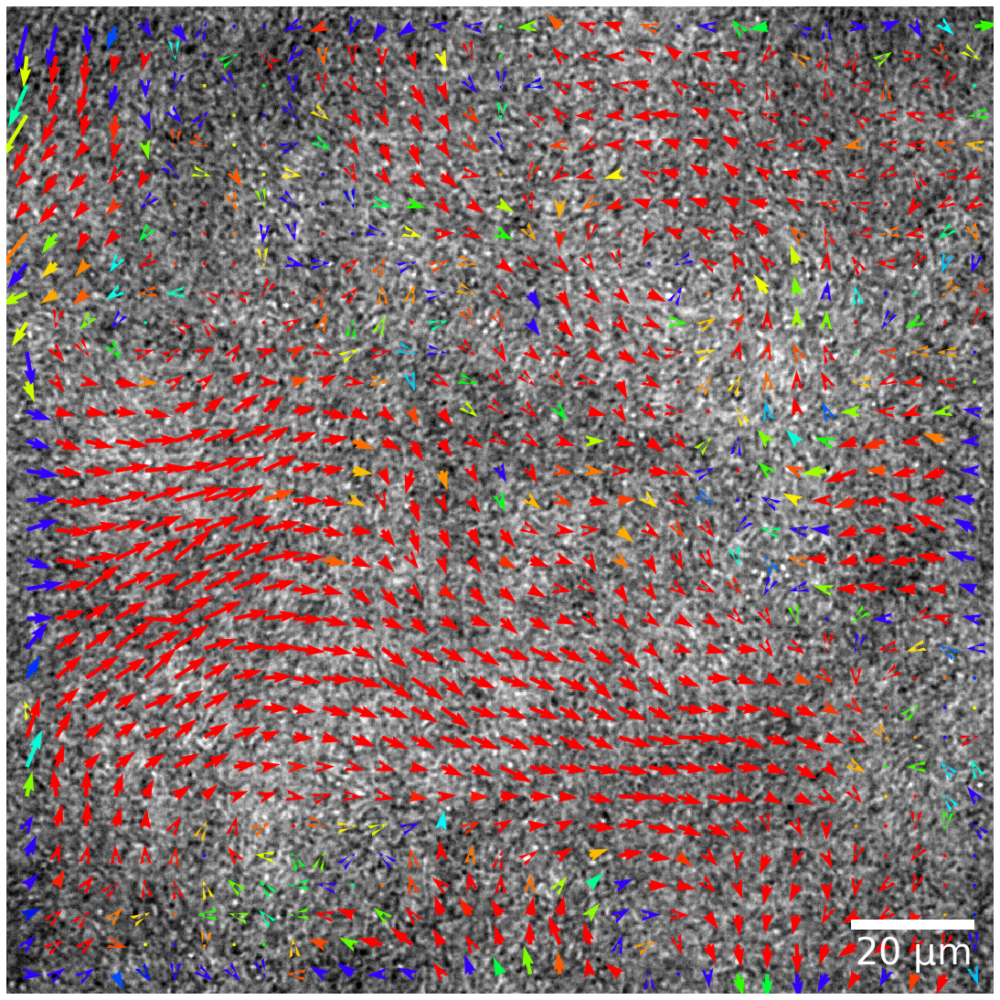

In [71]:
figsize = (15, 15)
fig = plt.figure(figsize=figsize)

ax = fig.add_axes([0,0,1,1])
img2 = np.flipud(img)
ax.imshow(img2, cmap='gray')
ax.quiver(pdata['X'], pdata['Y'], pdata['U'], -pdata['V'], pdata['C'], cmap=cmap,
          minshaft=-1, minlength=1, width=0.004, joinstyle='round')
#           headlength=3, headwidth=2, minshaft=-1, width=0.005, minlength=0, headaxislength=2)
ax.axis('off')
scalebar = ScaleBar(0.16, 'um', SI_LENGTH, frameon=False, color='white', font_properties={'size': 40},
                   pad=2, location='lower right', fixed_value=20) # 1 pixel = 0.2 1/cm
ax.add_artist(scalebar)
# fig.savefig('PIV_rainbow-im.eps', format='eps')
# fig.savefig('PIV_rainbow-im.pdf', format='pdf')
# fig.savefig('PIV_rainbow-im.png', format='png', dpi=300)

In [ ]:
# Scale down +, dots -

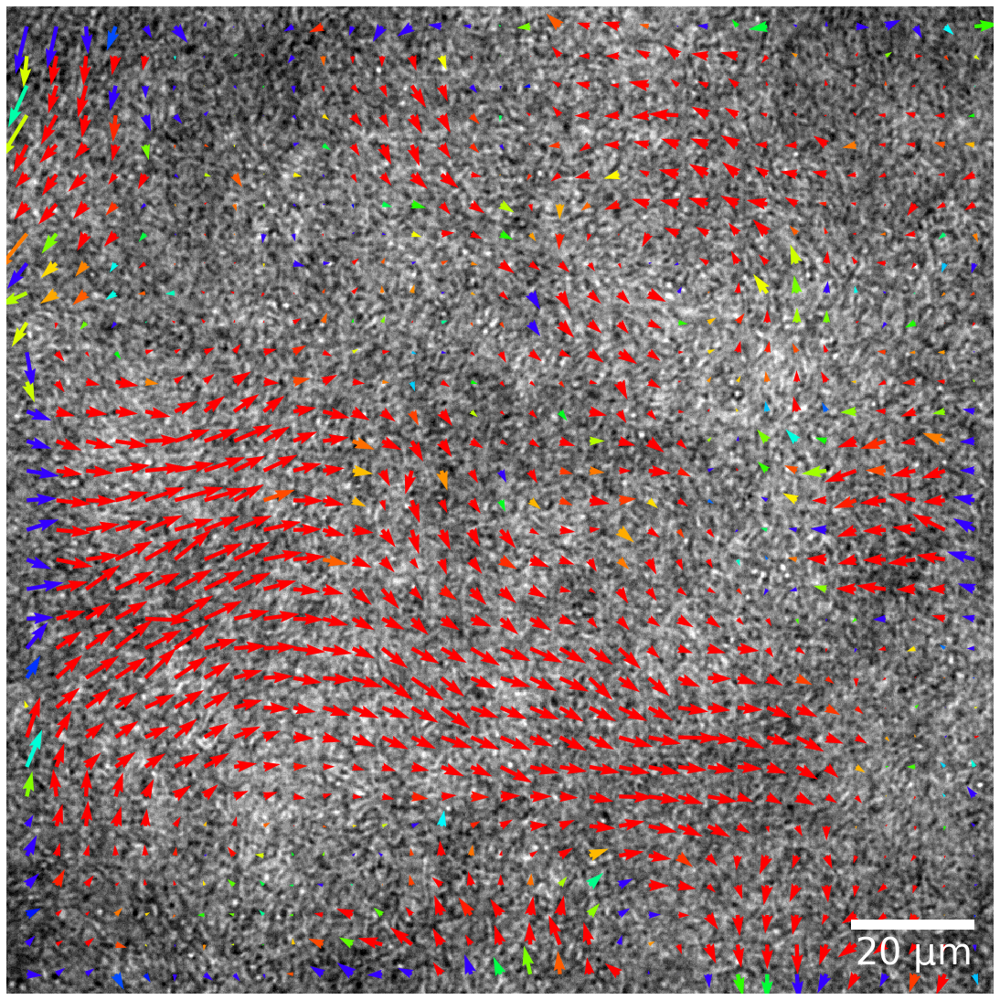

In [72]:
figsize = (15, 15)
fig = plt.figure(figsize=figsize)

ax = fig.add_axes([0,0,1,1])
img2 = np.flipud(img)
ax.imshow(img2, cmap='gray')
ax.quiver(pdata['X'], pdata['Y'], pdata['U'], -pdata['V'], pdata['C'], cmap=cmap,
          minshaft=1, minlength=0, width=0.004, joinstyle='round')
#           headlength=3, headwidth=2, minshaft=-1, width=0.005, minlength=0, headaxislength=2)
ax.axis('off')
scalebar = ScaleBar(0.16, 'um', SI_LENGTH, frameon=False, color='white', font_properties={'size': 40},
                   pad=2, location='lower right', fixed_value=20) # 1 pixel = 0.2 1/cm
ax.add_artist(scalebar)
# fig.savefig('PIV_rainbow-im.eps', format='eps')
# fig.savefig('PIV_rainbow-im.pdf', format='pdf')
# fig.savefig('PIV_rainbow-im.png', format='png', dpi=300)

In [ ]:
# Scale down -, dots -

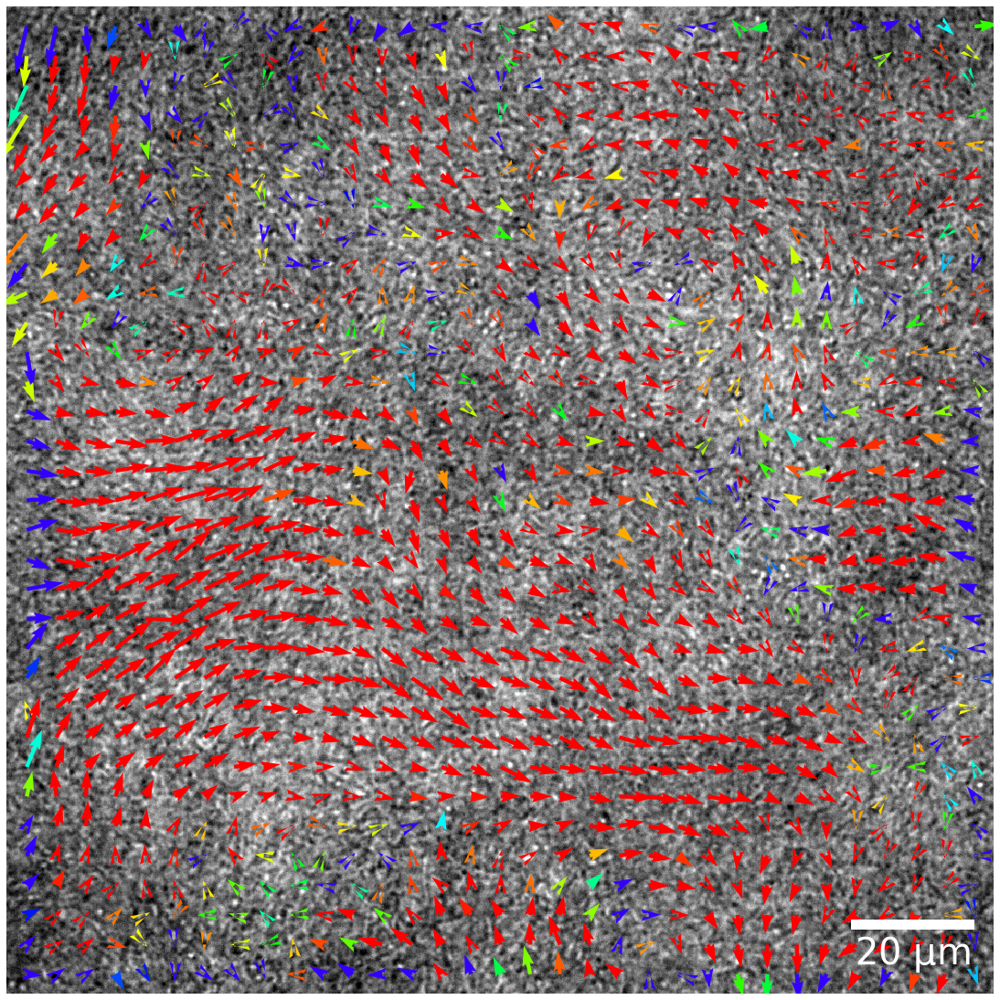

In [73]:
figsize = (15, 15)
fig = plt.figure(figsize=figsize)

ax = fig.add_axes([0,0,1,1])
img2 = np.flipud(img)
ax.imshow(img2, cmap='gray')
ax.quiver(pdata['X'], pdata['Y'], pdata['U'], -pdata['V'], pdata['C'], cmap=cmap,
          minshaft=-1, minlength=0, width=0.004, joinstyle='round')
#           headlength=3, headwidth=2, minshaft=-1, width=0.005, minlength=0, headaxislength=2)
ax.axis('off')
scalebar = ScaleBar(0.16, 'um', SI_LENGTH, frameon=False, color='white', font_properties={'size': 40},
                   pad=2, location='lower right', fixed_value=20) # 1 pixel = 0.2 1/cm
ax.add_artist(scalebar)
# fig.savefig('PIV_rainbow-im.eps', format='eps')
# fig.savefig('PIV_rainbow-im.pdf', format='pdf')
# fig.savefig('PIV_rainbow-im.png', format='png', dpi=300)

In [91]:
pdata = pd.DataFrame.from_dict(pdata, orient='index', columns=names)

ValueError: Must pass 2-d input

# Crop out the outer edge

In [121]:
imgDir = r'I:\Google Drive\Code\Python\Peng\PIV_rainbow\40x30fps80od_100p0rk_9vt1500.tif'
dataDir = r'I:\Google Drive\Code\Python\Peng\PIV_rainbow\fig1.dat'
img = plt.imread(imgDir)
data = pd.read_csv(dataDir, names=['X', 'Y', 'U', 'V', 'C'], sep='\t')
xlen = 65
ylen = 65
names = ['X', 'Y', 'U', 'V', 'C']
pdatac = {}
pdata = {}
pdatao = {}
for name in names:
    pdatao[name] = np.array(data[name]).reshape((xlen,ylen))
    pdata[name] = pdatao[name][0:xlen:2, 0:ylen:2]
    pdatac[name] = pdata[name][1:32, 1:32]

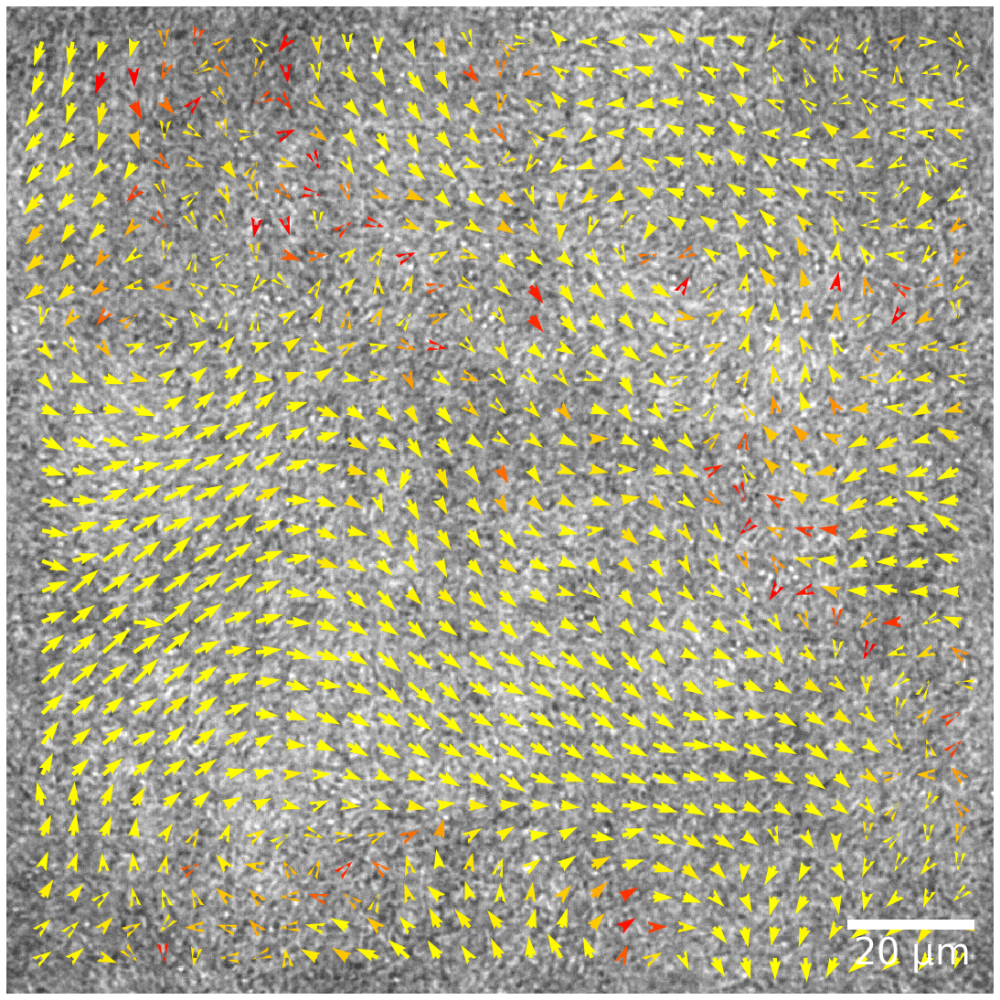

In [166]:
figsize = (15, 15)
fig = plt.figure(figsize=figsize)

ax = fig.add_axes([0,0,1,1])
img2 = np.flipud(img)
ax.imshow(img2, cmap='gray', alpha=0.75)
ax.quiver(pdatac['X'], pdatac['Y'], pdatac['U'], -pdatac['V'], pdatac['C'], cmap='autumn',
          minshaft=-1, minlength=0, width=0.004, joinstyle='round')
#           headlength=3, headwidth=2, minshaft=-1, width=0.005, minlength=0, headaxislength=2)
ax.axis('off')
ax.axis([15,985, 985, 15])
scalebar = ScaleBar(0.16, 'um', SI_LENGTH, frameon=False, color='white', font_properties={'size': 40},
                   pad=2, location='lower right', fixed_value=20) # 1 pixel = 0.2 1/cm
ax.add_artist(scalebar)
fig.savefig('PIV_autumn.eps', format='eps')
fig.savefig('PIV_autumn.pdf', format='pdf')
fig.savefig('PIV_autumn.png', format='png', dpi=300)

* logarithmic arrow length

In [2]:
imgDir = r'E:\Google Drive\Code\Python\Peng\PIV_rainbow\40x30fps80od_100p0rk_9vt1500.tif'
dataDir = r'E:\Google Drive\Code\Python\Peng\PIV_rainbow\fig1.dat'
img = plt.imread(imgDir)
data = pd.read_csv(dataDir, names=['X', 'Y', 'U', 'V', 'C'], sep='\t')
xlen = 65
ylen = 65
names = ['X', 'Y', 'U', 'V', 'C']
pdatac = {}
pdata = {}
pdatao = {}
for name in names:
    pdatao[name] = np.array(data[name]).reshape((xlen,ylen))
    pdata[name] = pdatao[name][0:xlen:2, 0:ylen:2]
    pdatac[name] = pdata[name][1:32, 1:32]
for name in ['U', 'V']:
    pdatac[name] = pdatac[name]/abs(pdatac[name])*np.log(abs(pdatac[name])+1)

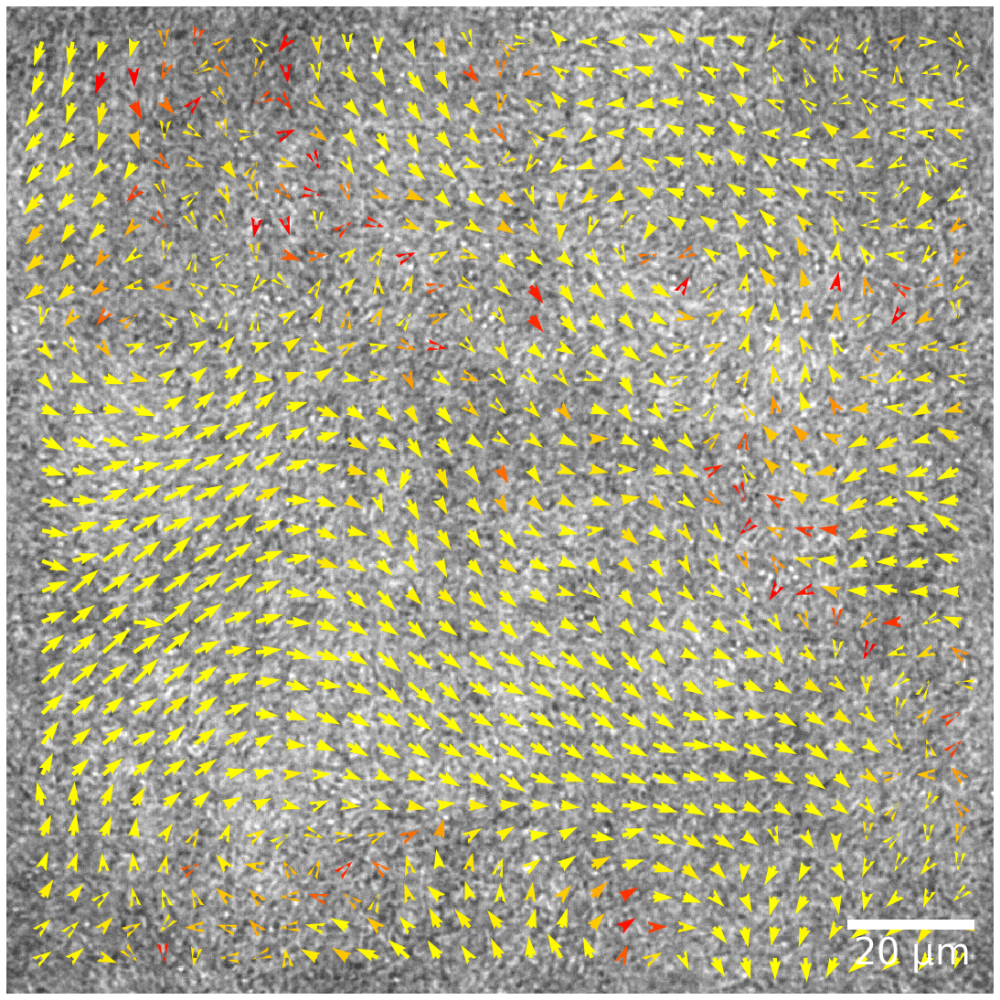

In [162]:
figsize = (15, 15)
fig = plt.figure(figsize=figsize)

ax = fig.add_axes([0,0,1,1])
img2 = np.flipud(img)
ax.imshow(img2, cmap='gray', alpha=0.75)
ax.quiver(pdatac['X'], pdatac['Y'], pdatac['U'], -pdatac['V'], pdatac['C'], cmap='autumn',
          minshaft=-1, minlength=0, width=0.004, joinstyle='round')
#           headlength=3, headwidth=2, minshaft=-1, width=0.005, minlength=0, headaxislength=2)
ax.axis('off')
ax.axis([15,985, 985, 15])
scalebar = ScaleBar(0.16, 'um', SI_LENGTH, frameon=False, color='white', font_properties={'size': 40},
                   pad=2, location='lower right', fixed_value=20) # 1 pixel = 0.2 1/cm
ax.add_artist(scalebar)

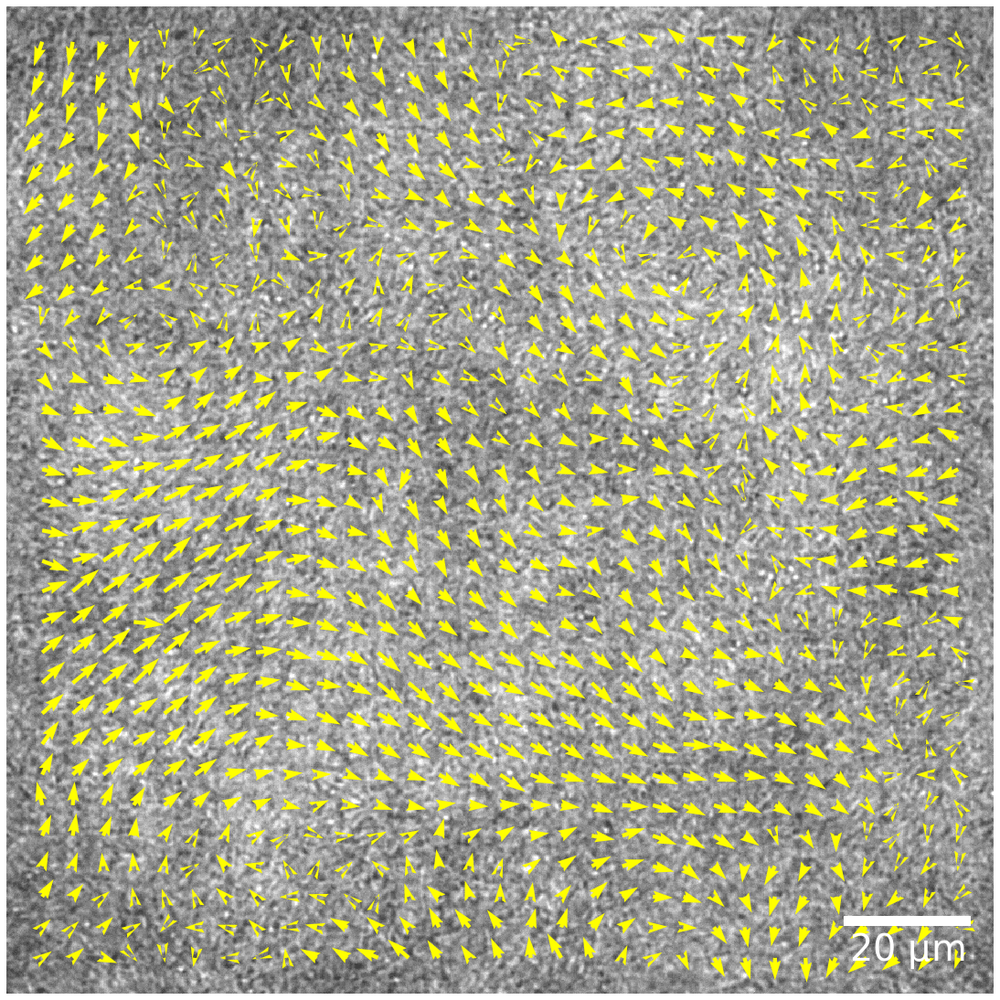

In [7]:
figsize = (15, 15)
fig = plt.figure(figsize=figsize)

ax = fig.add_axes([0,0,1,1])
img2 = np.flipud(img)
ax.imshow(img2, cmap='gray', alpha=0.75)
ax.quiver(pdatac['X'], pdatac['Y'], pdatac['U'], -pdatac['V'], color='yellow',
          minshaft=-1, minlength=0, width=0.004, joinstyle='round')
#           headlength=3, headwidth=2, minshaft=-1, width=0.005, minlength=0, headaxislength=2)
ax.axis('off')
ax.axis([15,985, 985, 15])
scalebar = ScaleBar(0.16, 'um', SI_LENGTH, frameon=False, color='white', font_properties={'size': 40},
                   pad=2, location='lower right', fixed_value=20) # 1 pixel = 0.2 1/cm
ax.add_artist(scalebar)
fig.savefig('PIV_yellow.pdf', format='pdf')

# Order parameter color map

In [39]:
import os
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
from scipy import interpolate

In [185]:
folder = r'E:\Google Drive\Code\MATLAB\Zhengyang\Research\misc\color_surface\test_data'
data = pd.read_csv(os.path.join(folder, 'orderen_60x10fps80n0_100pg0r_30perl_10umt301.dat'), names=['x', 'y', 'e', 'op', 'vort'], sep='\t')

(61.0, 1141.0, 61.0, 1741.0)

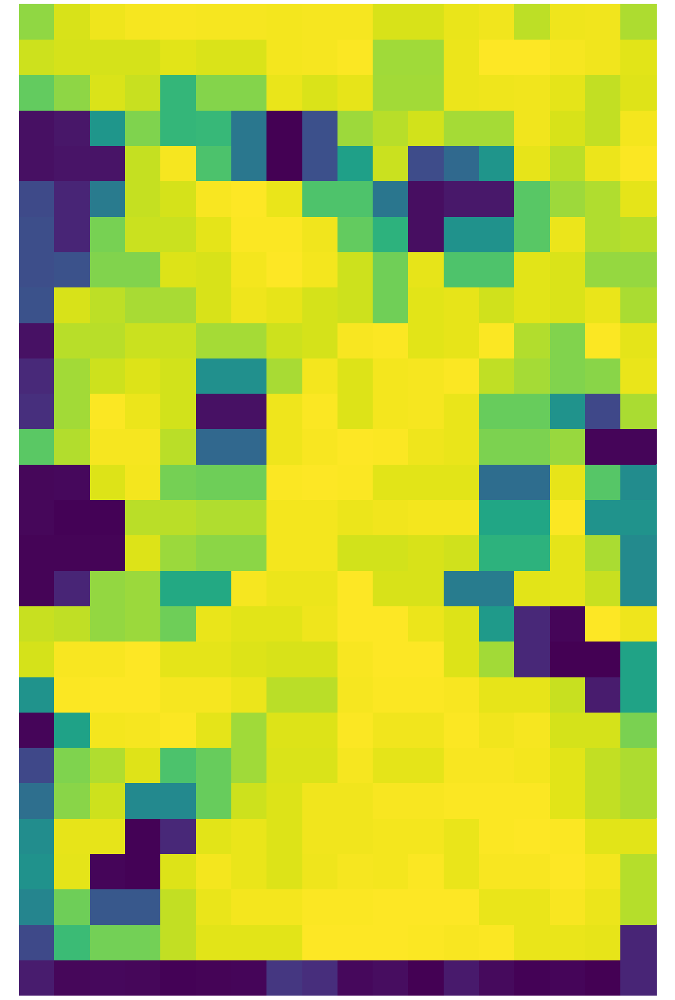

In [35]:
plt.figure(figsize=(19, 29))
nx = data.x.drop_duplicates().shape[0]
ny = data.y.drop_duplicates().shape[0]
plt.pcolor(np.array(data.x).reshape(nx, ny), np.array(data.y).reshape(nx, ny), np.array(data.op).reshape(nx, ny))
plt.axis('equal')
plt.axis('off')

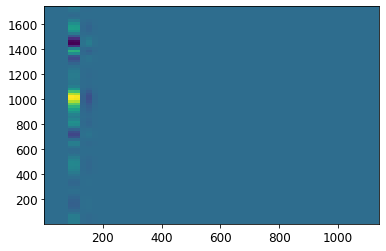

In [88]:
# smoothing to 1141*1741, spline, not done yet
%matplotlib inline
xnew, ynew = np.mgrid[1: data.x.max():3j*nx, 1: data.y.max():3j*ny]
tck = interpolate.bisplrep(np.array(data.x).reshape(nx, ny), np.array(data.y).reshape(nx, ny), np.array(data.op).reshape(nx, ny), s=0)
znew = interpolate.bisplev(xnew[:,0], ynew[0,:], tck)
plt.pcolor(xnew, ynew, znew-znew.mean())

(0.0, 1.0, 0.0, 1.0)

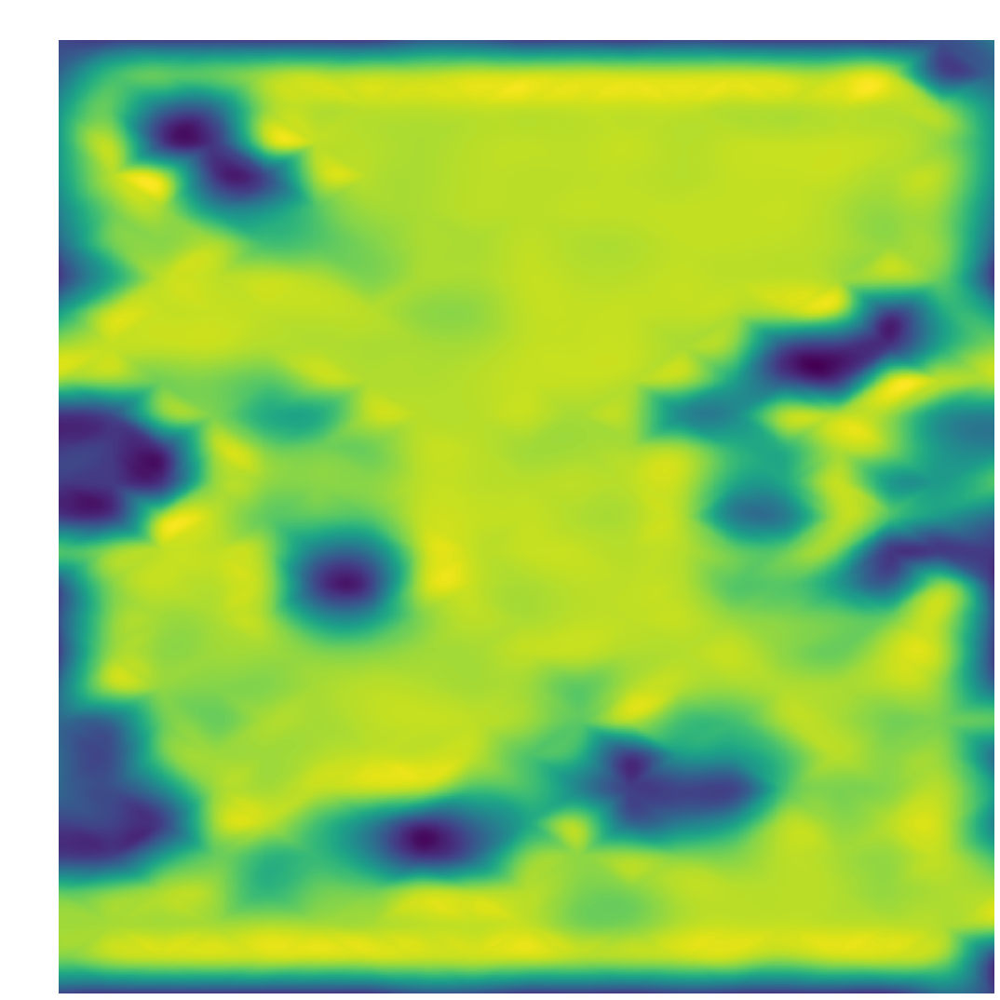

In [153]:
from scipy.interpolate import griddata
plt.figure(figsize=(19, 29))
points = np.array([np.array(data.x), np.array(data.y)]).transpose()
values = np.array(data.op)
xnew, ynew = np.mgrid[1: data.x.max():60j*nx, 1: data.y.max():60j*ny]
grid_z2 = griddata(points, values, (xnew, ynew), method='cubic')
plt.imshow(grid_z2.T, extent=(0,1,0,1))
plt.axis('off')

<IPython.core.display.Javascript object>


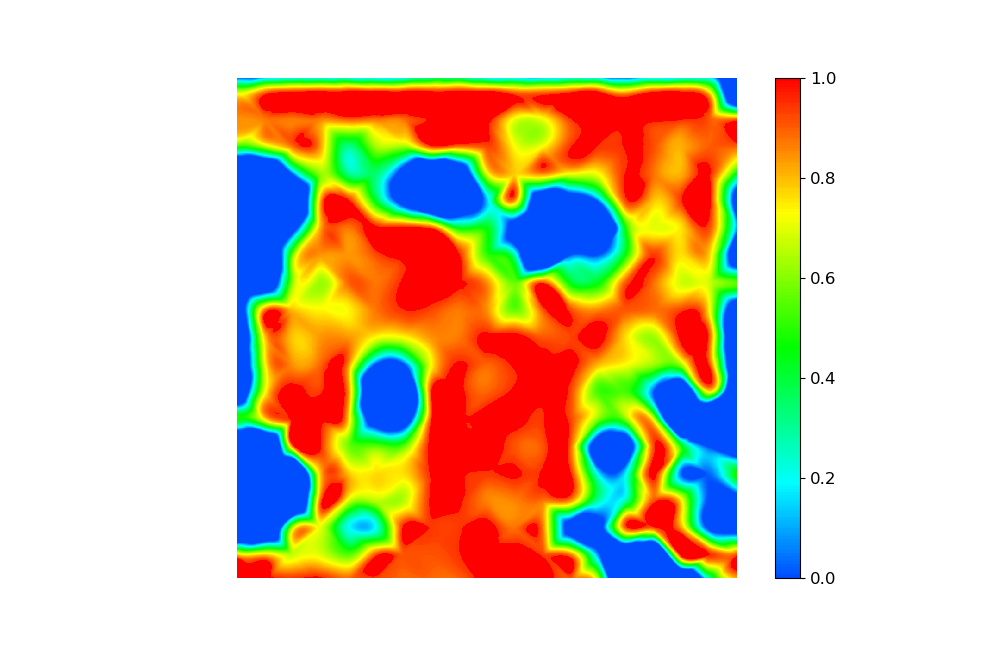

In [182]:
%matplotlib nbagg
# fig = plt.figure(figsize=(10, 15))
modify_color = np.nan_to_num(grid_z2)
modify_color[modify_color<0] = -0
modify_color[modify_color>.95] = 1
plt.imshow(np.flipud(modify_color.T)[30:grid_z2.shape[0]-10, 60:grid_z2.shape[1]-30], extent=(0,1,0,1), cmap=newcmp)
plt.axis('off')
plt.colorbar(ax=plt.gca())

In [183]:
plt.savefig(r'E:\Github\Python\ForFun\Peng\OP\OP_95.pdf', format='pdf')

# custom rainbow colormap (blue-red)

In [139]:
cL =  pd.read_csv(os.path.join(r'E:\Google Drive\Code\MATLAB\Zhengyang\Research\misc\color_surface', 'rainbow_color.csv'), 
                  names=['r', 'g', 'b'], sep=',')
cL /= 255
cL = cL.assign(a=1)
newcmp = ListedColormap(np.array(cL)[int(0.3*len(cL)):len(cL), :])

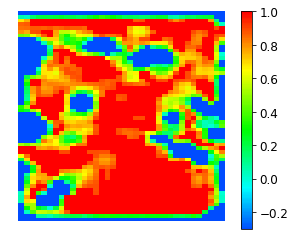

In [140]:
plt.imshow(np.flipud(grid_z2.T), extent=(0,1,0,1), cmap=newcmp)
plt.axis('off')
plt.colorbar()

In [118]:
def plot_examples(cms):
    """
    helper function to plot two colormaps
    """
    np.random.seed(19680801)
    data = np.random.randn(30, 30)

    fig, axs = plt.subplots(1, 2, figsize=(6, 3), constrained_layout=True)
    for [ax, cmap] in zip(axs, cms):
        psm = ax.pcolormesh(data, cmap=cmap, rasterized=True, vmin=-4, vmax=4)
        fig.colorbar(psm, ax=ax)
    plt.show()

<IPython.core.display.Javascript object>


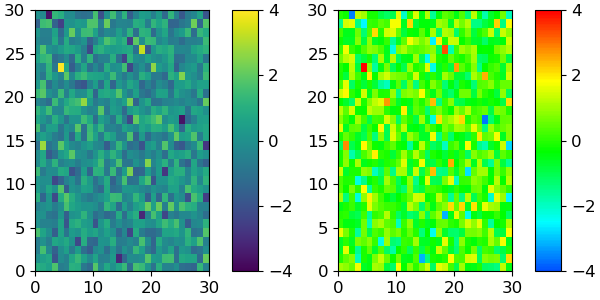

In [184]:
plot_examples([viridis, newcmp])

# Vorticity and streamline

In [188]:
pivdata = pd.read_csv(r'E:\Google Drive\Code\MATLAB\Zhengyang\Research\misc\streamLine\pivdata_1501_1530\pivdata.csv', names=['x', 'y', 'u', 'v', 'vor', 'a', 'b', 'c', 'd', 'e', 'f'])

E:\anaconda\lib\site-packages\ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in greater
  if sys.path[0] == '':
E:\anaconda\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in less
  del sys.path[0]


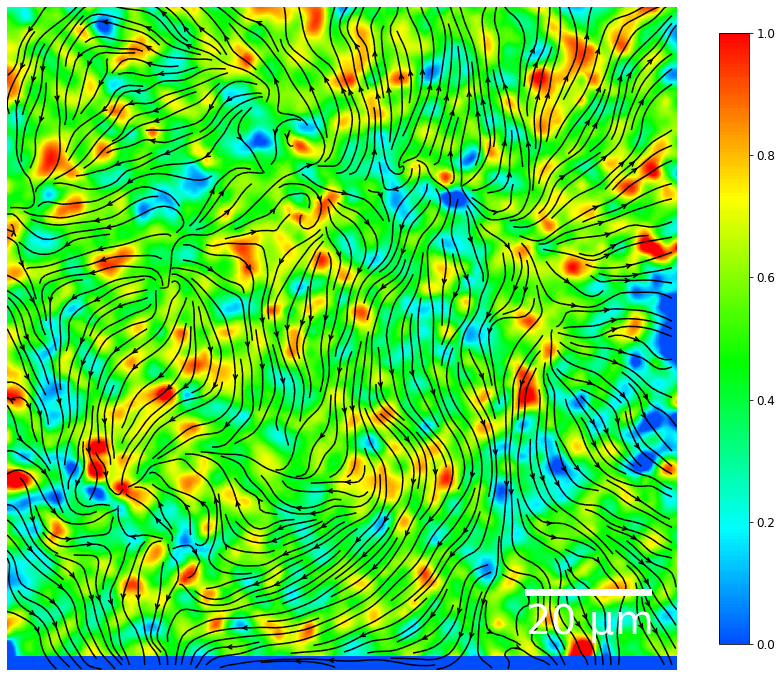

In [308]:
%matplotlib inline
points = np.array([np.array(pivdata.x), np.array(pivdata.y)]).transpose()
values = np.array(pivdata.vor)
nx = pivdata.x.drop_duplicates().shape[0]
ny = pivdata.y.drop_duplicates().shape[0]
xnew, ynew = np.mgrid[1: 1000 :1000j, 1: 1000:1000j]
smooth = griddata(points, values, (xnew, ynew), method='cubic')
minn = -0.06;
maxx = 0.06;
smooth = (smooth - minn) / (maxx-minn);
modify = np.nan_to_num(smooth)
modify[smooth>1] = 1;
modify[smooth<0] = 0;
fig, ax = plt.subplots(figsize=(15, 15))
scalebar = ScaleBar(0.11, 'um', SI_LENGTH, frameon=False, color='white', font_properties={'size': 40},
                   pad=2, location='lower right', fixed_value=20) # 1 pixel = 0.2 1/cm
ax.add_artist(scalebar)
h = ax.imshow(np.flipud(modify.T), cmap=newcmp)
fig.colorbar(h, ax=ax,shrink=0.75)
plt.axis('off')
plt.axis([20,980, 0,950])
# streamline
x = np.array(pivdata.x.drop_duplicates())
y = pivdata.y.max() - np.array(pivdata.y.drop_duplicates())
u = np.array(pivdata.u.drop_duplicates()).reshape(65, 65)
v = -np.array(pivdata.v.drop_duplicates()).reshape(65, 65)
ax.streamplot(x, y, u, v, density=3, linewidth=1.5, color='black', arrowstyle='->')
plt.savefig('E:\Github\Python\ForFun\Peng\streamline.pdf', format='pdf')

### Import MATLAB streamline data to plot

In [289]:
vert = pd.read_csv(r'E:\Google Drive\Code\MATLAB\Zhengyang\Research\misc\streamLine\vert.csv', names=['x', 'y', 'idx'])
avert = pd.read_csv(r'E:\Google Drive\Code\MATLAB\Zhengyang\Research\misc\streamLine\avert.csv', names=['x', 'y', 'idx'])

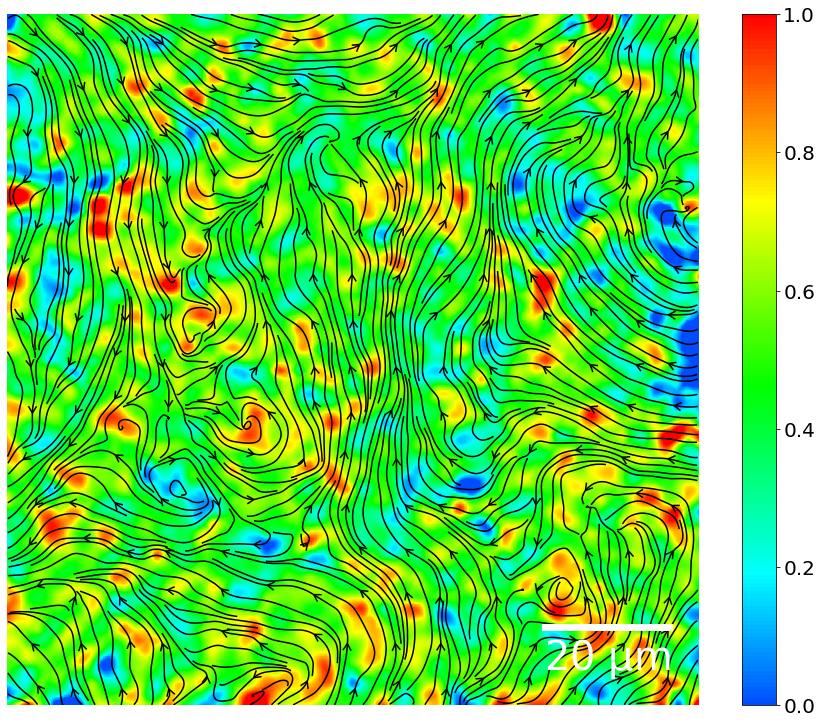

In [315]:
xmin = 20
xmax = 980
ymin = 20
ymax = 980
# Vorticity color plot
fig = plt.figure(figsize=(12, 12))
ax = fig.add_axes([0,0,1,1])
h = ax.imshow(modify.T, cmap=newcmp)
scalebar = ScaleBar(0.11, 'um', SI_LENGTH, frameon=False, color='white', font_properties={'size': 40},
                   pad=2, location='lower right', fixed_value=20) # 1 pixel = 0.2 1/cm
ax.add_artist(scalebar)
cbar = fig.colorbar(h, ax=ax,shrink=0.80)
cbar.ax.tick_params(labelsize=20) 
plt.axis('off')
plt.axis([xmin, xmax, ymin, ymax])
# Streamline
for i in vert.idx.drop_duplicates():
    subvert = vert.loc[vert.idx==i]
    subvert = subvert.loc[(subvert.x>xmin)&(subvert.x<xmax)&(subvert.y>ymin)&(subvert.y<ymax)]
    plt.plot(subvert.x, subvert.y, color='black')
for i in avert.idx.drop_duplicates():
    subavert = avert.loc[avert.idx==i]
    plt.plot(subavert.x, subavert.y, color='black')
plt.savefig('E:\Github\Python\ForFun\Peng\streamline\sl_sc.pdf', format='pdf')

In [305]:
modify.T.shape

(975, 975)